# FFT Base Model
Purpose:
- Simulating good data to mimic a sinusoidal pattern for heart rate
- Using this data to train the ANN model

Notes:
- no downsampling is applied
- only realistically applicable for heart rate, as Dr.Qazi confirmed a sinusoidal pattern

# Imports

In [1]:
# import libraries
import matplotlib.pyplot as plt
import math
import numpy as np
import os
import openpyxl
import pandas as pd
import sklearn
import random
from sklearn.preprocessing import normalize
from scipy.fft import fft, fftfreq, ifft
import ann_one_to_one_functions as ann_functions

# Loading/Preprocessing

In [2]:
#Referencing to local file where UQ vital signs data is located



"""
# Mounting google drive
from google.colab import drive
drive.mount('/content/drive')
"""

"\n# Mounting google drive\nfrom google.colab import drive\ndrive.mount('/content/drive')\n"

In [3]:
# Changing directory to the csv dataset needed
os.chdir("/Users/aaran/MHA_UPLOAD/MHA Data")

In [4]:
# Filtering the data
df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])

df = df.dropna() #drop rows with NaN

case4_filteredData = df.loc[(~df['HR'].isnull())]
case4_filteredData.drop('Time', axis=1, inplace=True)
# print(case4_filteredData.head(10))
# print(case4_filteredData.tail(10))
# print(case4_filteredData.shape)

/var/folders/yv/fxtprh2s52j94nnjg1219s_w0000gn/T/ipykernel_3021/3578882745.py:2: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])


In [5]:
# Filtering the data
df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])

df = df.dropna() #drop rows with NaN

case4_filteredData = df.loc[(~df['HR'].isnull())]
case4_filteredData.drop('Time', axis=1, inplace=True)
print(case4_filteredData.head(10))
print(case4_filteredData.tail(10))
print(case4_filteredData.shape)

/var/folders/yv/fxtprh2s52j94nnjg1219s_w0000gn/T/ipykernel_3021/3523865509.py:2: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  df = pd.read_csv("uq_vsd_case04_alldata.csv", index_col=False, error_bad_lines=False, usecols=['Time', 'HR'])


      HR
0  110.0
1  110.0
2  110.0
3  110.0
4  110.0
5  110.0
6  110.0
7  110.0
8  110.0
9  110.0
           HR
837315  131.0
837316  131.0
837317  131.0
837318  131.0
837319  131.0
837320  131.0
837321  131.0
837322  131.0
837323  131.0
837324  131.0
(837325, 1)


In [5]:
# # plot data
# dataset = case4_filteredData # use if google drive
# values = dataset.values

# # specify columns to plot
# groups = [0,1,2,3]
# i = 1
# for g in groups:
#   plt.subplot(len(groups), 1, i)
#   plt.plot(values[:, g])
#   plt.title(dataset.columns[g], y=0.5, loc='right')
#   i += 1
# # plt.show()

# FFT Forecasting

In [6]:
# Prepping the data
raw_var_data = case4_filteredData['HR'] # replace column name with variable you want

In [7]:
all_modified_data = np.copy(np.array(raw_var_data))
all_modified_data_list = list()

mean = 0
variances = [0.05, 0.1, 0.15, 0.2, 0.5, 3, 5]
for variance in variances:
  all_modified_data_copy = np.copy(all_modified_data)
  for j in range(0, 10):
    original_data = np.copy(np.array(raw_var_data))
    guass_noise = np.random.normal(0, variance, len(original_data))
    noisy_data = guass_noise + original_data
    all_modified_data_copy = np.append(all_modified_data_copy, noisy_data)
  all_modified_data_list.append(all_modified_data_copy)
print(len(all_modified_data_list[0]))

9210575


AttributeError: module 'matplotlib.pyplot' has no attribute 'set_ylabel'

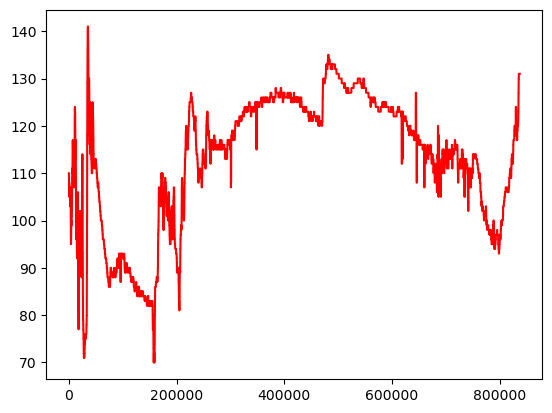

In [13]:
# # Plotting
# for data in all_modified_data_list:
#   plt.plot(data, 'b', label='Modified')
#   plt.plot(original_data, 'r', label='Original')
#   plt.title("FFT Base Model - Heart Rate (HR)")
#   plt.legend()
#   plt.figure(figsize=(20, 8))
#   plt.show()

/Users/aaran/MHA_Upload/Aaran's Modules/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upload/Aaran's Modules/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upload/Aaran's Modules/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upload/Aaran's Modules/model_tools.py:49: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_temp = df_temp.append(row, ignore_index = True)
/Users/aaran/MHA_Upl

TRAIN
This is shape of train features array: (68684, 5000, 1)
This is shape of train labels array: (68684, 1)
TEST
This is shape of test features array: (13421, 5000, 1)
This is shape of test labels array: (13421, 1)
Epoch 1/5000


2023-01-18 22:22:57.659107: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1503/1503 [==============================] - ETA: 0s - loss: 0.0076 - accuracy: 0.0000e+00

2023-01-18 22:30:05.648520: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1503/1503 [==============================] - 495s 327ms/step - loss: 0.0076 - accuracy: 0.0000e+00 - val_loss: 0.0026 - val_accuracy: 0.0000e+00
Epoch 2/5000
1503/1503 [==============================] - 1908s 1s/step - loss: 0.0023 - accuracy: 0.0000e+00 - val_loss: 0.0015 - val_accuracy: 0.0000e+00
Epoch 3/5000
1503/1503 [==============================] - 934s 621ms/step - loss: 0.0016 - accuracy: 0.0000e+00 - val_loss: 9.9938e-04 - val_accuracy: 0.0000e+00
Epoch 4/5000
1503/1503 [==============================] - 556s 370ms/step - loss: 0.0012 - accuracy: 0.0000e+00 - val_loss: 8.4356e-04 - val_accuracy: 0.0000e+00
Epoch 5/5000
1503/1503 [==============================] - 552s 367ms/step - loss: 0.0010 - accuracy: 0.0000e+00 - val_loss: 0.0011 - val_accuracy: 0.0000e+00
Epoch 5: early stopping
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_2 (Normalizat  (None, 50

2023-01-18 23:37:11.287406: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


2147/2147 [==============================] - 243s 113ms/step
RMSE:  0.03505404381810853
R2 (Sklearn): 0.9622031906280902
MAE: 0.025175306513917105
MAPE: 0.04982146682714454
420/420 [==============================] - 47s 113ms/step
RMSE:  0.03278941755273215
R2 (Sklearn): 0.9611282926724539
MAE: 0.023999436760908533
MAPE: 0.04440239787244193
0
1/1 [==============================] - 0s 128ms/step
1
1/1 [==============================] - 0s 15ms/step
2
1/1 [==============================] - 0s 18ms/step
3
1/1 [==============================] - 0s 13ms/step
4
1/1 [==============================] - 0s 15ms/step
5
1/1 [==============================] - 0s 13ms/step
6
1/1 [==============================] - 0s 13ms/step
7
1/1 [==============================] - 0s 13ms/step
8
1/1 [==============================] - 0s 13ms/step
9
1/1 [==============================] - 0s 13ms/step
10
1/1 [==============================] - 0s 12ms/step
11
1/1 [==============================] - 0s 12ms/step
12
1/1

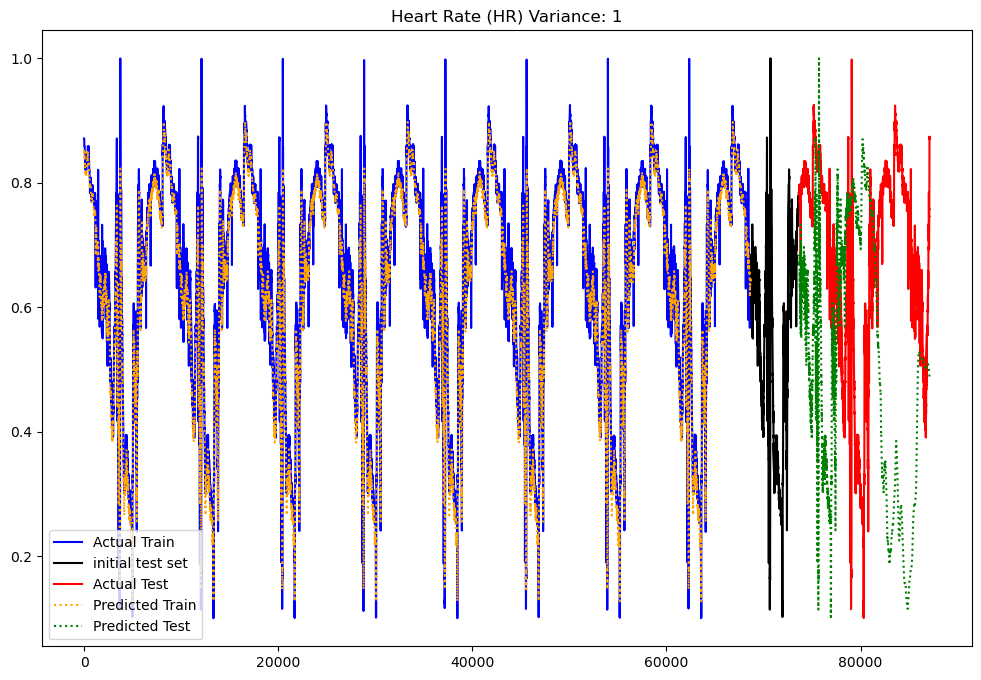

In [10]:
train_results = dict()
test_results = dict()
long_term_results = dict()
train_features = dict()
train_labels = dict()
test_features = dict()
test_labels = dict()
train_pred = dict()
test_pred = dict()
long_term_pred = dict()

for i in range(len(variances)):
    data = pd.DataFrame(all_modified_data_list[i], columns = ["HR"])
    train_results[str(variances[i])], test_results[str(variances[i])], long_term_results[str(variances[i])], train_features[str(variances[i])], train_labels[str(variances[i])], test_features[str(variances[i])], test_labels[str(variances[i])], train_pred[str(variances[i])], test_pred[str(variances[i])], long_term_pred[str(variances[i])] = ann_functions.test_model_from_df(data, ["HR"], downsample_window = 100, numOfPrevValues = 5000, batch_num = None, epoch_num = 5000, learn_rate = 0.000001, numOfUnits_list = [512])

for variance in train_results.keys():
    print(f'Variance: {variance}')
    print(f'Train Predictions: RMSE: {train_results[variance]["rmse"]}, R^2: {train_results[variance]["r2"]}, MAE: {train_results[variance]["mae"]}, MAPE: {train_results[variance]["mape"]}')
    print(f'Test Predictions: RMSE: {test_results[variance]["rmse"]}, R^2: {test_results[variance]["r2"]}, MAE: {test_results[variance]["mae"]}, MAPE: {test_results[variance]["mape"]}')
    print(f'Long Term Predictions: RMSE: {long_term_results[variance]["rmse"]}, R^2: {long_term_results[variance]["r2"]}, MAE: {long_term_results[variance]["mae"]}, MAPE: {long_term_results[variance]["mape"]}')

for variance in train_pred.keys():
    fig = plt.figure(figsize=(12, 8))
    xtrain_set = np.arange(0, len(train_features[variance]))
    ytrain_set = np.array(train_labels[variance][:])
    plt.plot(xtrain_set, ytrain_set, 'b', label="Actual Train")

    xtest_given = np.arange(len(train_features[variance]), len(train_features[variance]) + 5000)
    ytest_given = test_features[variance][0]
    plt.plot(xtest_given, ytest_given, color='black', label="initial test set")

    xtest_set = np.arange(len(train_features[variance]) + 5000, len(train_features[variance]) + len(test_features[variance]) + 5000)
    ytest_set = np.array(test_labels[variance][:])
    plt.plot(xtest_set, ytest_set, 'r', label="Actual Test")

    pred_train_sig = np.array(train_pred[variance][:])
    plt.plot(xtrain_set, pred_train_sig, 'orange', label="Predicted Train", linestyle="dotted")

    pred_test_sig = np.array(long_term_pred[variance][:])
    plt.plot(xtest_set, pred_test_sig,'green', label="Predicted Test", linestyle="dotted")
    plt.title(f'Heart Rate (HR) Variance: {variance}')
    plt.legend()
    plt.show()

# data = pd.DataFrame(all_modified_data_list[0], columns = ["HR"])
# ann_functions.test_model_from_df(data, ["HR"], downsample_window = 100, numOfPrevValues = 1000, batch_num = None, epoch_num = 5000, learn_rate = 0.000001, numOfUnits_list = [512])

In [11]:
data = pd.DataFrame(all_modified_data_list[0], columns = ["HR"])
print(data)

                 HR
0        110.000000
1        110.000000
2        110.000000
3        110.000000
4        110.000000
...             ...
9210570  130.965642
9210571  131.007827
9210572  131.086725
9210573  130.968354
9210574  130.973506

[9210575 rows x 1 columns]
